In [1]:
include("kim and nelson.jl")
using .julia


In [2]:
using LinearAlgebra
using Random
using Distributions
using ProgressMeter
using Statistics  
using SpecialFunctions
using NLopt

using Plots
using StatsPlots  
using DataFrames
using XLSX

## Simulate data

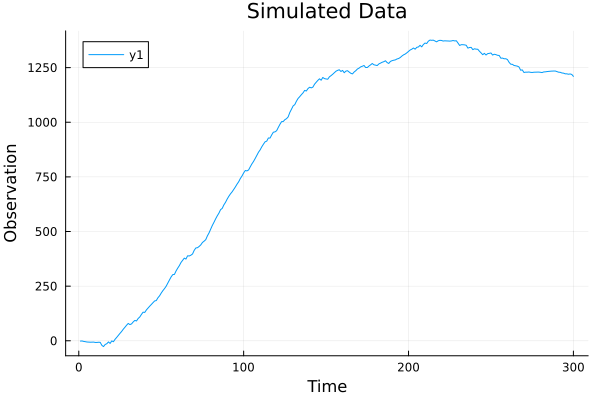

In [3]:
# Define initial state and covariance
state_dim = 4
a1 = zeros(state_dim)
P1 = Matrix{Float64}(I(state_dim))*10  # Initial covariance matrix

# True parameters for simulation
psi1 = 0.6
psi2 = 0.2
sigma_xi2 = 0.8
sigma_kappa2_0 = 0.5
sigma_kappa2_1 = 1.2
sigma_epsilon2_0 = 0.6
sigma_epsilon2_1 = 1.1
omega = -10
p = 0.4
q = 0.8


params_true = [psi1, psi2, sigma_xi2, sigma_kappa2_0, sigma_kappa2_1, sigma_epsilon2_0, sigma_epsilon2_1, omega, p, q]

n_obs = 300  # Number of observations

# Simulate data
y, alpha = simulate_data(params_true, n_obs, a1)


plot(y, title="Simulated Data", xlabel="Time", ylabel="Observation")




In [4]:
Z, T, R, Q_0, Q_1, nu0, nu1, H = state_space(params_true)
println("Z: ", Z)
println("T: ", T)
println("R: ", R)
println("Q_0: ", Q_0)
println("Q_1: ", Q_1)
println("nu0: ", nu0)
println("nu1: ", nu1)
println("H: ", H)

Z: [1.0, 0.0, 1.0, 0.0]
T: [1.0 1.0 0.0 0.0; 0.0 1.0 0.0 0.0; 0.0 0.0 0.6 0.2; 0.0 0.0 1.0 0.0]
R: [1.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0; 0.0 0.0 1.0 0.0; 0.0 0.0 0.0 0.0]
Q_0: [0.6 0.0 0.0 0.0; 0.0 0.8 0.0 0.0; 0.0 0.0 0.5 0.0; 0.0 0.0 0.0 0.0]
Q_1: [1.1 0.0 0.0 0.0; 0.0 0.8 0.0 0.0; 0.0 0.0 1.2 0.0; 0.0 0.0 0.0 0.0]
nu0: [0.0, 0.0, 0.0, 0.0]
nu1: [0.0, 0.0, -10.0, 0.0]
H: 0


In [5]:
logL, a, p_res = switching_kalman_filter(y, params_true, a1, P1)

(-773.4232486128833, [-0.4640174066651387 -0.2311721783929944 -0.8233247107195673 -0.13870330703579667; -0.1424446189348631 0.3754238494463539 -0.680267675273968 -0.6987620974097432; … ; 1218.9993028852036 -1.1084849182503496 -0.23610344237577824 0.3939018966429198; 1219.5273709914084 -0.31985303718793645 -9.594578611380125 -0.5007746822185625], [0.9263626576403079 0.07363734235969216; 0.9786295450907496 0.021370454909250408; … ; 0.9998885547754424 0.00011144522455755353; 0.0001086086380295439 0.9998913913619706])

## Estimate

In [6]:
#Define model
alpha_init = zeros(state_dim)
alpha_init[1] = y[1]
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

#Priors
a_psi1 = 0.01
b_psi1 = 0.97
a_psi2 = 0.01
b_psi2 = 0.97
a_xi = 1e-6
b_xi = 1e-6
a_kappa_0 = 1e-6
b_kappa_0 = 1e-6
a_kappa_1 = 1e-6
b_kappa_1 = 1e-6
a_epsilon_0 = 1e-6
b_epsilon_0 = 1e-6
a_epsilon_1 = 1e-6
b_epsilon_1 = 1e-6
a_omega = -100
b_omega = 0
a_p = 0.01
b_p = 0.99
a_q = 0.01
b_q = 0.99
# a_sigma_y = 1e-6
# b_sigma_y = 1e-6
priors = [a_psi1, b_psi1, a_psi2, b_psi2, a_xi, b_xi, a_kappa_0, b_kappa_0, a_kappa_1, b_kappa_1, a_epsilon_0, b_epsilon_0, a_epsilon_1, b_epsilon_1, a_omega, b_omega, a_p, b_p, a_q, b_q]




20-element Vector{Float64}:
    0.01
    0.97
    0.01
    0.97
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
 -100.0
    0.0
    0.01
    0.99
    0.01
    0.99

In [7]:
# Run MCMC initialization
chain_init_burned, Sigma, acceptance_rate_init, chain_init = initialize_mcmc(
    y,
    priors,
    alpha_init, 
    P1; 
    n_init=40000, 
    burn_init=20000, 
    omega_init=0.003)

Initialization Phase 100%|███████████████████████████████| Time: 0:02:519m


Initialization Acceptance Rate: 49.36 %


([0.6642451105503445 -1.1251763334286828 … -0.37404691308180127 1.6066383889364586; 0.6642451105503445 -1.1251763334286828 … -0.37404691308180127 1.6066383889364586; … ; 0.5950309447733765 -1.2308862635103874 … -0.030930577210232096 1.5433486361433761; 0.6321589639993895 -1.2691059679718806 … -0.08229860325048202 1.6284105296847413], [0.013895842800853132 -0.0007678446719043542 … -0.00012451312237784254 -0.00019113028749013865; -0.0007678446719043542 0.02036803988372122 … 0.0017722374613427343 0.0016596086031797112; … ; -0.00012451312237784254 0.0017722374613427343 … 0.05491464045660051 0.004537223427150164; -0.00019113028749013865 0.0016596086031797112 … 0.004537223427150164 0.03219156431658235], 0.4936, [0.0 0.0 … 0.0 0.0; 0.009928969570501298 0.003276924342280302 … -0.004380421937896239 0.0540947437530584; … ; 0.5950309447733765 -1.2308862635103874 … -0.030930577210232096 1.5433486361433761; 0.6321589639993895 -1.2691059679718806 … -0.08229860325048202 1.6284105296847413], [0.643804

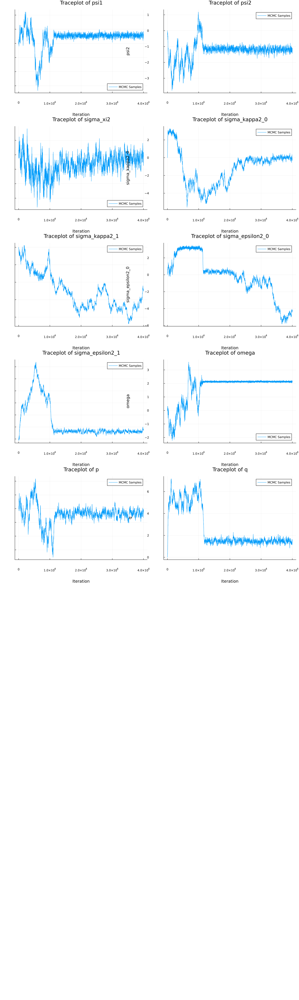

In [8]:
parameters = ["psi1", "psi2", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples_init = chain_init[:, i]
    
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples_init, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")

    
    # Add plots to the list
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [9]:
# Run MCMC recursion
theta_samples_burned, alpha_samples, acceptance_rate_rec, p_res = recursion_mcmc(
    y, 
    priors,
    alpha_init, 
    P1, 
    chain_init_burned, 
    Sigma; 
    n_rec=40000, 
    burn_rec=20000, 
    omega_rec=0.1)


Recursion Phase 100%|████████████████████████████████████| Time: 0:04:48


Recursion Acceptance Rate: 22.49 %


([0.6362148801071339 0.22811134173468087 … 0.4492900766717242 0.8021117494419159; 0.6362148801071339 0.22811134173468087 … 0.4492900766717242 0.8021117494419159; … ; 0.6407658902040186 0.22555861985582817 … 0.37252070327077164 0.856076936844646; 0.6407658902040186 0.22555861985582817 … 0.37252070327077164 0.856076936844646], Any[[0.6061343315585486 0.937635459280661 -1.8934764489432545 0.5965376313104432; 2.2159331969235336 1.5416112697343518 -3.0386454911323644 -1.936908827372792; … ; 1219.6949509405072 -1.2733832018938782 -0.9317514976791316 -1.0438294515135238; 1220.66839479666 -0.31318134700330486 -10.735602416631835 -0.9312369036247061], [0.6061343315585486 0.937635459280661 -1.8934764489432545 0.5965376313104432; 2.2159331969235336 1.5416112697343518 -3.0386454911323644 -1.936908827372792; … ; 1219.6949509405072 -1.2733832018938782 -0.9317514976791316 -1.0438294515135238; 1220.66839479666 -0.31318134700330486 -10.735602416631835 -0.9312369036247061], [0.6061343315585486 0.9376354

In [10]:


# Number of optimization runs
num_runs = 1

upper_bounds = [1.0, 2 * π, Inf, Inf, Inf, Inf, Inf, Inf, 1.0, 1.0]
lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -Inf, 0.0, 0.0]

              
# Function to generate initial parameters from specified priors
function draw_initial_params(parameters)
    initial_params = Float64[]  # Enforce Float64 type for the parameters
    for param in parameters
        if param == "psi1"
            # Uniform prior between 0 and 0.999
            push!(initial_params, rand(Uniform(a_psi1, b_psi1)))
        elseif param == "psi2"
            # Uniform prior between 0 and π
            push!(initial_params, rand(Uniform(a_psi2, b_psi2)))
        elseif param in ["p", "q"]
            # Uniform prior between 0 and 1
            push!(initial_params, rand(Uniform(0.01, 0.99)))
        elseif param == "omega"
            # Normal prior with mean -0.5 and std 0.1
            push!(initial_params, rand(Normal(-0.5, 0.5)))
        else
            # Inverse-Gamma prior
            push!(initial_params, rand(InverseGamma(3, 1)))
        end
    end
    return initial_params
end

# Define the objective function
function obj(params::Vector, grad::Vector)
    try
        return neg_log_likelihood(params, y, alpha_init, P1, n_order)
    catch e
        return 1e10  # Return a large number in case of error
    end
end

# Run optimization with multiple initial guesses

best_minf = Inf
best_params = nothing

pb = Progress(num_runs; desc="MLE Optimization")
for run in 1:num_runs
    
    # Draw a new set of initial parameters from priors
    initial_params = draw_initial_params(parameters)

    # Create the optimizer
    opt = Opt(:LN_NELDERMEAD, length(initial_params))
    opt.lower_bounds = lower_bounds
    opt.upper_bounds = upper_bounds
    opt.min_objective = obj
    opt.maxeval = 100000
    opt.xtol_rel = 1e-6

    # Run the optimization
    (minf, estimated_params, ret) = NLopt.optimize(opt, initial_params)
 
    # Save the best result
    if minf < best_minf
        best_minf = minf
        best_params = estimated_params
    end

    next!(pb)
end


# Display the best estimated parameters
println("Best Estimated Parameters: ", best_params)


Best Estimated Parameters: [0.8193637031785654, 0.24497137835064864, 0.1902117649056038, 0.1174206296063322, 0.2939103837260202, 0.33330684738696115, 0.2874029688255523, -0.10845486098023907, 0.1446905108162167, 0.09551173582642766]


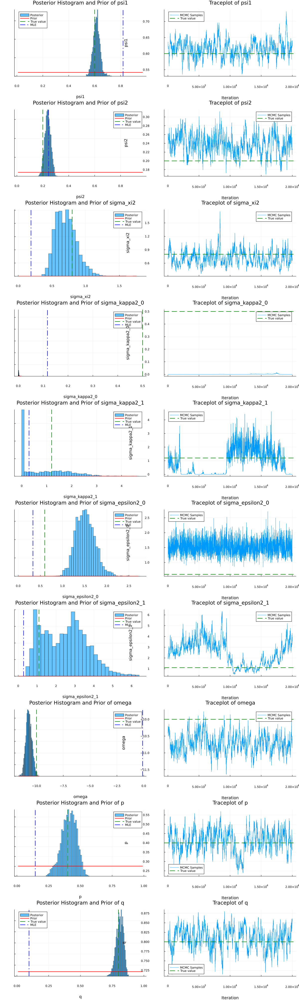

In [11]:
# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples = theta_samples_burned[:, i]
    
    # Histogram of posterior samples
    p1 = histogram(param_samples, bins=50, normalize=true, alpha=0.6,
                   label="Posterior", xlabel=parameters[i], ylabel="Density",
                   title="Posterior Histogram and Prior of $(parameters[i])")
    
    # Define the prior distribution
    if parameters[i] == "psi1"
        # Uniform prior between 0 and 0.999
        a = a_psi1
        b = b_psi1
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "psi2"
        # Uniform prior between 0 and 1
        a = a_psi2
        b = b_psi2
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] in ["p", "q"]
        # Uniform prior between 0 and 1
        a = a_p
        b = 1b_p
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "omega"
        a = a_omega
        b = b_omega
        x_values = range(minimum(param_samples), maximum(param_samples), length=200)
        prior_pdf = pdf.(Normal(a, b), x_values)
    elseif parameters[i] == "sigma_xi2"
        a = a_xi
        b = b_xi
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_0"
        a = a_kappa_0
        b = b_kappa_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_1"
        a = a_kappa_1
        b = b_kappa_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_0"
        a = a_epsilon_0
        b = b_epsilon_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_1"
        a = a_epsilon_1
        b = b_epsilon_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_y"
        a = a_sigma_y
        b = b_sigma_y
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    end
    
    # Overlay prior PDF on histogram
    plot!(p1, x_values, prior_pdf, label="Prior", color=:red, linewidth=2)
    
    # Include true parameter value
    vline!(p1, [params_true[i]], label="True value", color=:green, linestyle=:dash, linewidth=2)
    
    #MLE estimates
    vline!(p1, [best_params[i]], label="MLE", color=:blue, linestyle=:dashdot, linewidth=2)
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")
    hline!(p2, [params_true[i]], label="True value", color=:green, linestyle=:dash, linewidth=2)
    
    # Add plots to the list
    push!(p_list, p1)
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [12]:
# Calculate means of posterior samples
chain_rec_burned_means = mean(theta_samples_burned, dims=1)  # 1 x n_params array
chain_rec_burned_means = vec(chain_rec_burned_means)  # Convert to a vector


10-element Vector{Float64}:
   0.6145948506435823
   0.2380562506150267
   0.7124898073859307
   0.0007084121136433759
   0.8777382648101293
   1.5141642655256746
   2.4781582762908703
 -10.705372241629329
   0.4102140853677469
   0.8103850354649694

In [13]:

# Create the DataFrame
data = DataFrame(Dict(
    "Parameter" => parameters,
    "MCMC Estimate" => chain_rec_burned_means,
    "MLE Estimate" => best_params,  # Include if available
    "True Value" => params_true
))

# Display the DataFrame
display(data)


Row,MCMC Estimate,MLE Estimate,Parameter,True Value
,Float64,Float64,String,Float64
1,0.614595,0.819364,psi1,0.6
2,0.238056,0.244971,psi2,0.2
3,0.71249,0.190212,sigma_xi2,0.8
4,0.000708412,0.117421,sigma_kappa2_0,0.5
5,0.877738,0.29391,sigma_kappa2_1,1.2
6,1.51416,0.333307,sigma_epsilon2_0,0.6
7,2.47816,0.287403,sigma_epsilon2_1,1.1
8,-10.7054,-0.108455,omega,-10.0
9,0.410214,0.144691,p,0.4


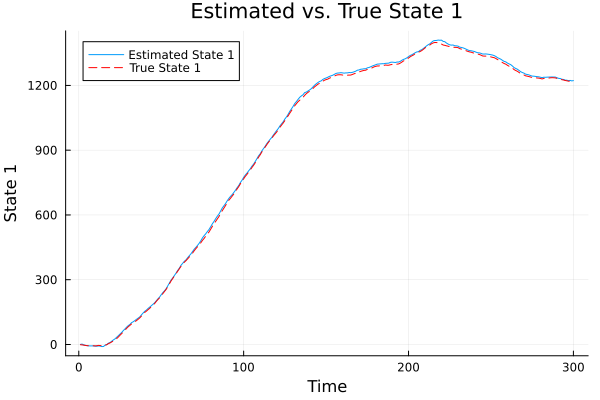

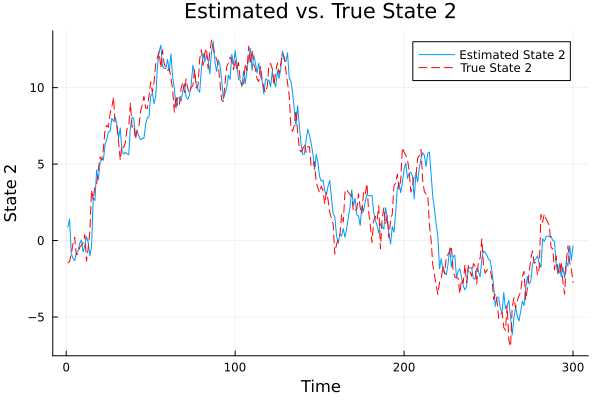

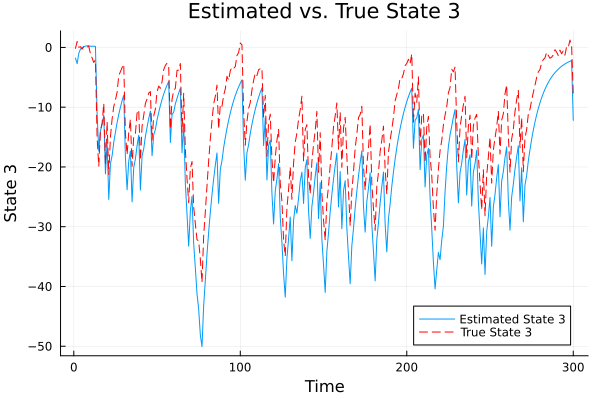

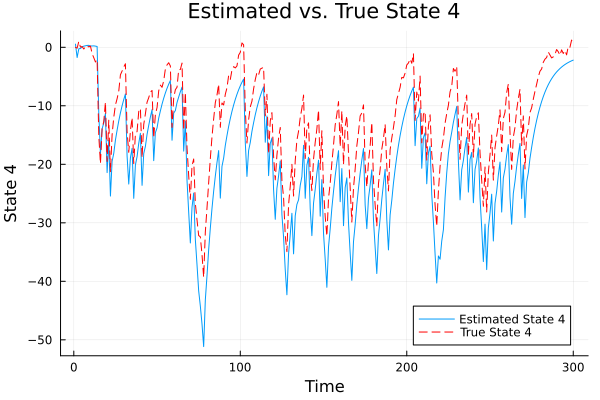

In [14]:


n_samples = length(alpha_samples)
n_time_steps = size(alpha_samples[1], 1)
state_dim = size(alpha_samples[1], 2)

# Initialize array to hold alpha samples
alpha_samples_array = Array{Float64}(undef, n_samples, n_time_steps, state_dim)
# Collect alpha samples into a 3D array
for i in 1:n_samples
    alpha_samples_array[i, :, :] = alpha_samples[i]
end



# Compute posterior mean over samples (dimension 1)
alpha_mean = mean(alpha_samples_array, dims=1)  # 1 x n_time_steps x state_dim
alpha_mean = dropdims(alpha_mean; dims=1)  # n_time_steps x state_dim

# Compute credible intervals
alpha_lower = mapslices(x -> quantile(x, 0.025), alpha_samples_array; dims=1)
alpha_lower = dropdims(alpha_lower; dims=1)
alpha_upper = mapslices(x -> quantile(x, 0.975), alpha_samples_array; dims=1)
alpha_upper = dropdims(alpha_upper; dims=1)



time = 1:n_time_steps

for s in 1:state_dim
    p = plot(time, alpha_mean[:, s], label="Estimated State $(s)", xlabel="Time",
             ylabel="State $(s)", title="Estimated vs. True State $(s)")
    
    # Add credible intervals using the `ribbon` argument
    # plot!(time, alpha_mean[:, s], ribbon=(alpha_mean[:, s] .- alpha_lower[:, s],
    #       alpha_upper[:, s] .- alpha_mean[:, s]), fillalpha=0.3, label="95% Credible Interval")
    
    # Plot true state (assuming you have `alpha_true` from data simulation)
    plot!(time, alpha[1:n_time_steps, s], label="True State $(s)", linestyle=:dash, color=:red)
    
    display(p)
end


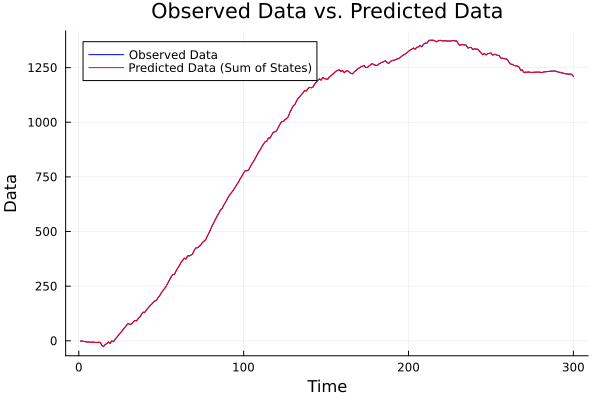

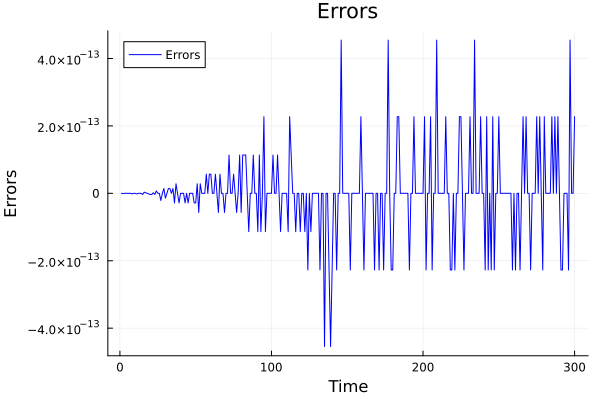

In [15]:
# Compute y_pred
state_indices = [1, 3]  # Adjust as necessary

y_pred = alpha_mean[:, state_indices[1]] .+ alpha_mean[:, state_indices[2]]

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(time, y_adjusted, label="Observed Data", color=:blue)
plot!(p, time, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted Data")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(time, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)


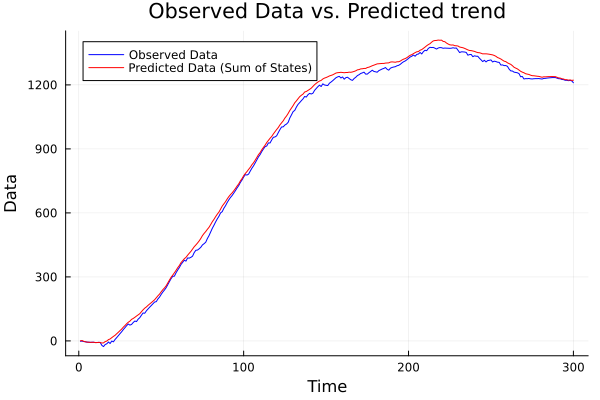

In [16]:
# estimated state 1 and true observation y
# Compute y_pred
state_indices = [1, 3]  # Adjust as necessary

y_pred = alpha_mean[:, state_indices[1]] 

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(time, y_adjusted, label="Observed Data", color=:blue)
plot!(p, time, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted trend")
display(p)



